In [1]:
# Installation des bibliothèques
!pip install pymongo plotly ipywidgets

# Imports des bibliothèques standard
import time
from datetime import datetime, timedelta
import numpy as np
import pandas as pd

# Imports pour la visualisation
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go

# Imports pour les widgets interactifs
import ipywidgets as widgets
from IPython.display import display

# Imports pour l'apprentissage automatique (Scikit-learn)
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV, learning_curve
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import PolynomialFeatures, StandardScaler
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline


# Imports spécifiques à Google Colab
from google.colab import drive

# Imports pour MongoDB
from pymongo import MongoClient

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 10.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 313.6/313.6 kB 6.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 32.4 MB/s eta 0:00:00


In [2]:
# Monter Google Drive
drive.mount('/content/drive')

# Chemin du fichier dans ton Google Drive (exemple)
file_path = '/content/drive/MyDrive/Colab Notebooks/DataPatisserieIndustrielle2017-2018.xlsx'

# Lire le fichier Excel
data_2017_2018 = pd.read_excel(file_path)

# Afficher les premières lignes du fichier
data_2017_2018.head()

Mounted at /content/drive


,Année,Trimestre,Mois,Région,Gouvernorat,Délégation,Canal,Catégorie,Famille,Sous-Famille,Segment,Marque,Produit,Référence,Présence en Unités,Présence en Valeur,Vente estimée en Unités,Vente estimée en Valeur,Prix Moyen,CA
0,2017,2017-1,2017-01,Sud Est,Mednine,Zarzis,Epicerie,EPICERIE,Epicerie sucrée,Patisserie Industrielle,CAKE,QUEEN,ALL BLACKS,ALL BLACKS,1415.294118,707.647059,4458.176471,2229.088235,500.0,2.229088e+06
1,2017,2017-1,2017-01,Grand Tunis,Tunis,Bab Souika,Hammas,EPICERIE,Epicerie sucrée,Patisserie Industrielle,CAKE,MOULIN BLANC,AMANDINE MOULIN BLANC,AMANDINE MOULIN BLANC,733.333333,330.000000,2383.333333,1072.500000,450.0,1.072500e+06
2,2017,2017-1,2017-01,Sud Est,Sfax,Bir Ali Ben Khelifa,Hammas,EPICERIE,Epicerie sucrée,Patisserie Industrielle,CAKE,MOULIN BLANC,AMANDINE MOULIN BLANC,AMANDINE MOULIN BLANC,2116.666667,952.500000,6604.000000,2971.800000,450.0,2.971800e+06
3,2017,2017-1,2017-01,Sub Ouest,Tozeur,Degueche,Hammas,EPICERIE,Epicerie sucrée,Patisserie Industrielle,CAKE,MOULIN BLANC,AMANDINE MOULIN BLANC,AMANDINE MOULIN BLANC,1063.636364,425.454545,3829.090909,1531.636364,400.0,1.531636e+06
4,2017,2017-1,2017-01,Grand Tunis,Tunis,El Kram,Superette,EPICERIE,Epicerie sucrée,Patisserie Industrielle,CAKE,MOULIN BLANC,AMANDINE MOULIN BLANC,AMANDINE MOULIN BLANC,641.052632,320.526316,2019.315789,1009.657895,500.0,1.009658e+06


Statistiques descriptives :
       Présence en Unités  Présence en Valeur  Vente estimée en Unités  \
count       181247.000000       181247.000000            181247.000000   
mean          1063.864243          514.799384              3267.768374   
std           1125.403580          545.080921              3380.549795   
min              5.785714            0.000000                 0.000000   
25%            442.285714          208.190325              1356.750000   
50%            764.307692          367.500000              2376.000000   
75%           1295.333333          635.294118              4041.713710   
max          59313.333333        32622.333333            158844.000000   

       Vente estimée en Valeur     Prix Moyen            CA  
count            181247.000000  181409.000000  1.812450e+05  
mean               1524.225296     537.933928  1.524119e+06  
std                1545.679879     381.179832  1.545482e+06  
min                   0.000000       5.000000  0.000000e+

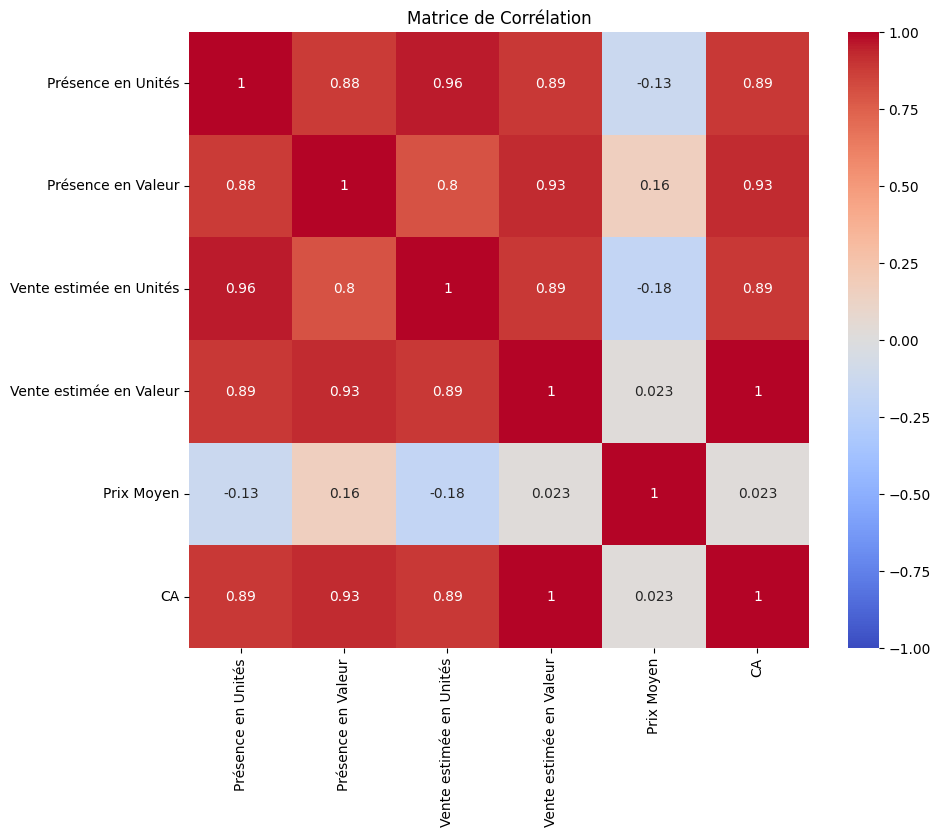

In [ ]:

# Liste des colonnes numériques
numerical_columns = ['Présence en Unités', 'Présence en Valeur', 'Vente estimée en Unités',
                     'Vente estimée en Valeur', 'Prix Moyen', 'CA']

# Obtenir les statistiques descriptives pour les colonnes numériques
distribution_stats = data_2017_2018[numerical_columns].describe()

# Afficher le tableau des statistiques descriptives
print("Statistiques descriptives :")
print(distribution_stats)

# Calculer la matrice de corrélation pour ces colonnes
correlation_matrix = data_2017_2018[numerical_columns].corr()

# Afficher la matrice de corrélation
print("\nMatrice de corrélation :")
print(correlation_matrix)

# Représentation graphique de la matrice de corrélation
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Matrice de Corrélation')
plt.show()


Valeurs nulles par colonne :
Présence en Unités         164
Présence en Valeur         164
Vente estimée en Unités    164
Vente estimée en Valeur    164
Prix Moyen                   2
CA                         166
dtype: int64

Proportion de valeurs nulles par colonne :
Présence en Unités         0.000904
Présence en Valeur         0.000904
Vente estimée en Unités    0.000904
Vente estimée en Valeur    0.000904
Prix Moyen                 0.000011
CA                         0.000915
dtype: float64

# Les colonnes 'Présence en Unités', 'Présence en Valeur', 'Vente estimée en Unités', 'Vente estimée en Valeur',
 et 'CA' présentent un nombre non négligeable de valeurs nulles (164 à 166 valeurs, soit environ 0.09%).
# La colonne 'Prix Moyen' présente seulement 2 valeurs nulles (environ 0.001%), ce qui est insignifiant.

Résumé des outliers par colonne :

Colonne : Présence en Unités
 Limite inférieure : -837.28571427
 Limite supérieure : 2574.90476189
 Nombre d'outliers : 12190
 Pourcentag

<Figure size 1500x1500 with 0 Axes>

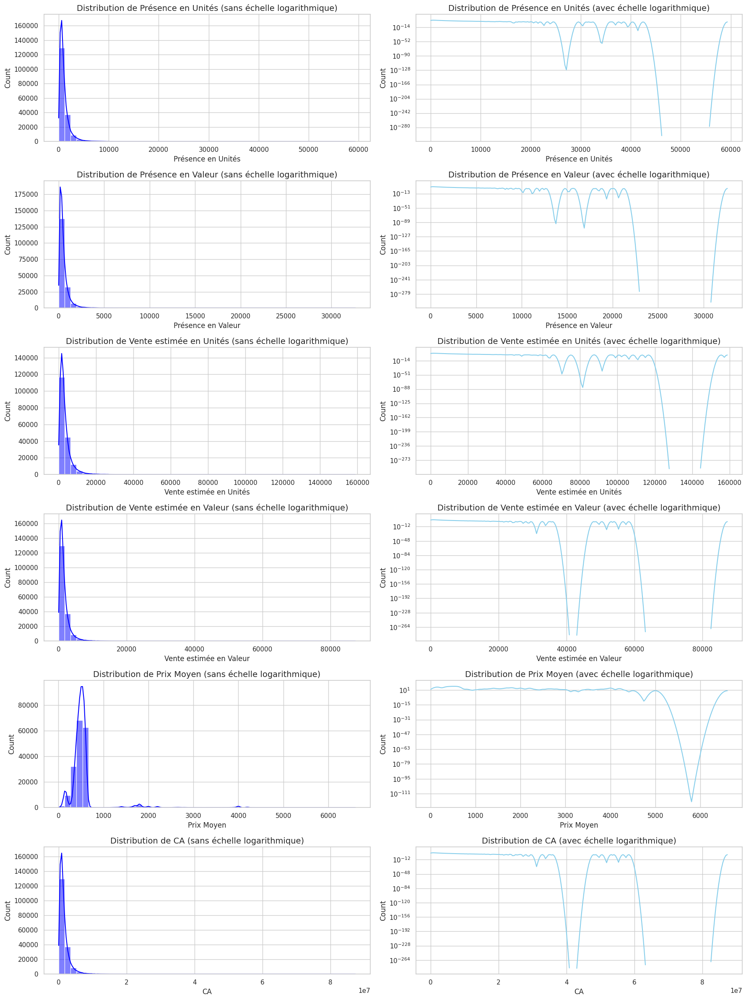

In [ ]:
# Étape 1 : Vérification des valeurs nulles dans les colonnes numériques
null_counts = data_2017_2018[numerical_columns].isnull().sum()
null_proportion = data_2017_2018[numerical_columns].isnull().mean()

# Affichage des résultats pour les valeurs nulles
print("Valeurs nulles par colonne :")
print(null_counts)
print("\nProportion de valeurs nulles par colonne :")
print(null_proportion)

# Étape 2 : Identification des outliers en utilisant la méthode IQR (Interquartile Range)
outliers_summary = {}
for col in numerical_columns:
    Q1 = data_2017_2018[col].quantile(0.25)
    Q3 = data_2017_2018[col].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    outliers = data_2017_2018[(data_2017_2018[col] < lower_bound) | (data_2017_2018[col] > upper_bound)][col]
    outliers_summary[col] = {
        'lower_bound': lower_bound,
        'upper_bound': upper_bound,
        'outliers_count': len(outliers),
        'outliers_percentage': len(outliers) / len(data_2017_2018) * 100
    }
print("\n# Les colonnes 'Présence en Unités', 'Présence en Valeur', 'Vente estimée en Unités', 'Vente estimée en Valeur',\n et 'CA' présentent un nombre non négligeable de valeurs nulles (164 à 166 valeurs, soit environ 0.09%).")
print("# La colonne 'Prix Moyen' présente seulement 2 valeurs nulles (environ 0.001%), ce qui est insignifiant.")

# Affichage des résultats pour les outliers
print("\nRésumé des outliers par colonne :")
for col, summary in outliers_summary.items():
    print(f"\nColonne : {col}")
    print(f" Limite inférieure : {summary['lower_bound']}")
    print(f" Limite supérieure : {summary['upper_bound']}")
    print(f" Nombre d'outliers : {summary['outliers_count']}")
    print(f" Pourcentage d'outliers : {summary['outliers_percentage']:.2f}%")
print("\n# 'Présence en Unités', 'Présence en Valeur', 'Vente estimée en Unités', 'Vente estimée en Valeur', et 'CA' montrent environ 6-7% d'outliers. Cela signifie qu'une part notable\n des données dépasse les limites calculées via l'IQR. La limite supérieure est souvent dépassée, ce qui peut indiquer une forte variation dans les données ou des valeurs exceptionnellement élevées.")
print("# 'Prix Moyen' a un taux d'outliers particulièrement élevé (près de 10%), avec des valeurs qui sortent de l'intervalle [300, 700]. Cette distribution suggère que certains\n prix moyens sont soit très bas, soit très élevés, ce qui pourrait être un artefact des données ou une réalité du marché.\n")

# Définir la taille des graphiques et le style
plt.figure(figsize=(15, 15))
sns.set(style="whitegrid")

# Création de la figure avec des sous-graphiques (2 lignes pour chaque variable)
fig, axes = plt.subplots(len(numerical_columns), 2, figsize=(18, 4 * len(numerical_columns)))

# Tracer chaque distribution des colonnes numériques avec et sans échelle logarithmique
for i, col in enumerate(numerical_columns):
    # Distribution sans échelle logarithmique
    sns.histplot(data_2017_2018[col], kde=True, ax=axes[i, 0], color="blue", bins=50)
    axes[i, 0].set_title(f'Distribution de {col} (sans échelle logarithmique)', fontsize=14)
    axes[i, 0].set_xlabel(col)

    # Distribution avec échelle logarithmique sur l'axe y
    sns.histplot(data_2017_2018[col], kde=True, ax=axes[i, 1], color="skyblue", bins=50, log_scale=(False, True))
    axes[i, 1].set_title(f'Distribution de {col} (avec échelle logarithmique)', fontsize=14)
    axes[i, 1].set_xlabel(col)

# Ajuster l'affichage
plt.tight_layout()
plt.show()


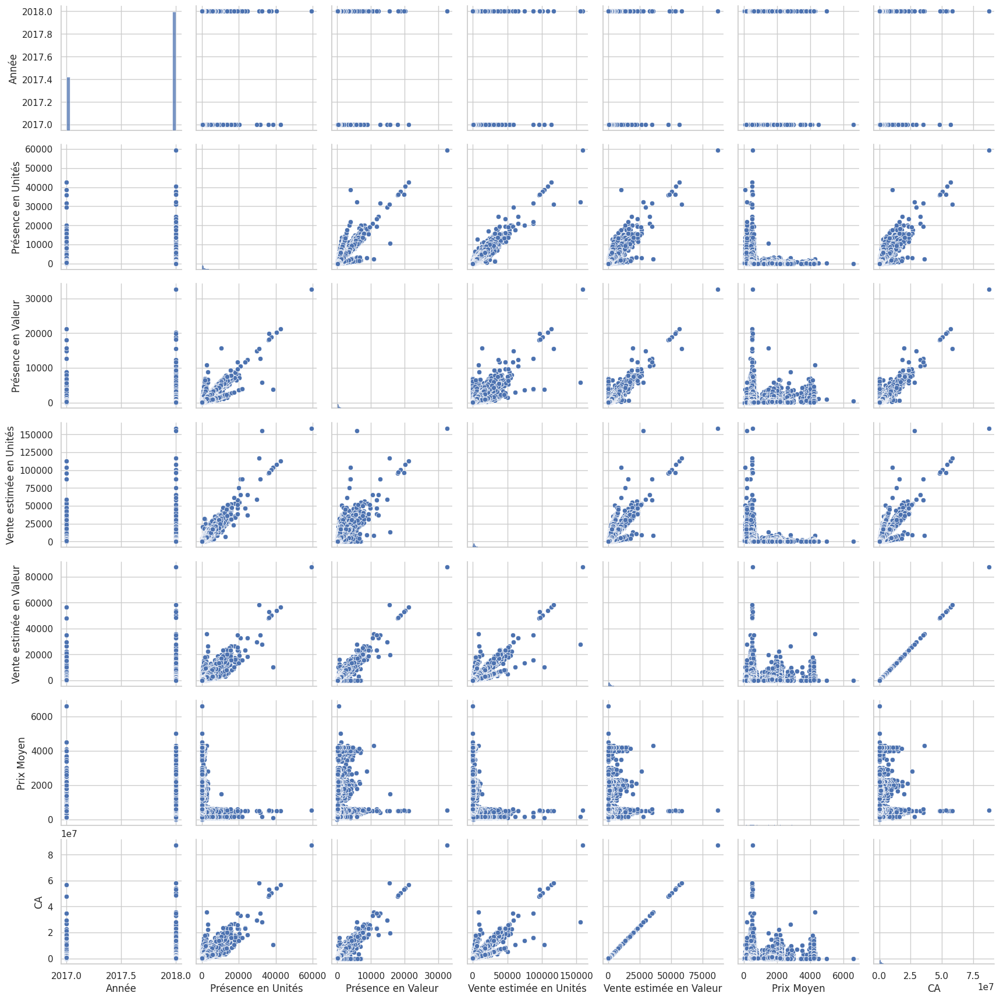

In [ ]:
sns.pairplot(data_2017_2018)
plt.show()

In [ ]:

# Define numerical_columns here:
numerical_columns = ['Présence en Unités', 'Présence en Valeur', 'Vente estimée en Unités',
                     'Vente estimée en Valeur', 'Prix Moyen', 'CA']

for feature in numerical_columns:
    fig = px.scatter(data_2017_2018, x=feature, y='CA',
                     title=f'CA vs. {feature}',
                     trendline='ols', trendline_color_override='red')  # Ajoute une droite de régression linéaire
    fig.show()

Buffered data was truncated after reaching the output size limit.

In [9]:
# Sélection des features, incluant les colonnes encodées pour 'Mois'
X = data_2017_2018[['Mois', 'Année', 'Trimestre', 'Présence en Unités', 'Présence en Valeur', 'Vente estimée en Unités',
                   'Vente estimée en Valeur', 'Prix Moyen']]
y = data_2017_2018[['CA']]

# Create a list of numerical features for imputation
numerical_features = ['Présence en Unités', 'Présence en Valeur', 'Vente estimée en Unités',
                     'Vente estimée en Valeur', 'Prix Moyen']

X.loc[:, 'Mois'] = pd.to_datetime(X['Mois'], format='%Y-%m', errors='coerce').dt.month
X.loc[:, 'Trimestre'] = X['Trimestre'].str.split('-').str[1].astype(int)
X.loc[:, 'Année'] = X['Année'].astype(int)  # Convert 'Année' to int

# Imputer les valeurs manquantes dans X avec la moyenne for numerical features only
imputer = SimpleImputer(strategy='mean')
X.loc[:, numerical_features] = imputer.fit_transform(X[numerical_features])

# Imputer les valeurs manquantes dans y (cible)
y_imputer = SimpleImputer(strategy='mean')
y = y_imputer.fit_transform(y)

# Séparer les données en ensembles d'entraînement et de test (80% entraînement, 20% test)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Étape 1: Régression linéaire
linear_model = LinearRegression()
linear_model.fit(X_train, y_train)

# Prédictions pour l'ensemble de test
y_pred_linear = linear_model.predict(X_test)

# Évaluation du modèle de régression linéaire
mse_linear = mean_squared_error(y_test, y_pred_linear)
r2_linear = r2_score(y_test, y_pred_linear)
print(f"Régression linéaire - MSE: {mse_linear}, R²: {r2_linear}")

# Étape 2: Régression polynomiale (modèle non linéaire)
poly = PolynomialFeatures(degree=2)  # Utilisation d'un polynôme de degré 2
X_train_poly = poly.fit_transform(X_train)
X_test_poly = poly.transform(X_test)

# Entraîner le modèle sur les features transformées
poly_model = LinearRegression()
poly_model.fit(X_train_poly, y_train)

# Prédictions pour l'ensemble de test (polynomial)
y_pred_poly = poly_model.predict(X_test_poly)

# Évaluation du modèle de régression polynomiale
mse_poly = mean_squared_error(y_test, y_pred_poly)
r2_poly = r2_score(y_test, y_pred_poly)
print(f"Régression polynomiale (degré 2) - MSE: {mse_poly}, R²: {r2_poly}")

# Étape 3: Modèle de forêt aléatoire
rf_model = RandomForestRegressor(random_state=42)
rf_model.fit(X_train, y_train.ravel())

# Prédictions et évaluation
y_pred_rf = rf_model.predict(X_test)

#Évaluation du modèle de forêt aléatoire
mse_rf = mean_squared_error(y_test, y_pred_rf)
r2_rf = r2_score(y_test, y_pred_rf)
print(f"Forêt aléatoire - MSE: {mse_rf}, R²: {r2_rf}")


Régression linéaire - MSE: 709747.9037141396, R²: 0.9999997138677139
Régression polynomiale (degré 2) - MSE: 34110775.1065645, R²: 0.9999862483650729
Forêt aléatoire - MSE: 27797785251.021507, R²: 0.9887934239735006


In [12]:
# 1. Validation croisée pour le modèle linéaire
cv_scores_linear = cross_val_score(linear_model, X, y.ravel(), cv=5, scoring='r2') # Use X instead of X_imputed and y instead of y_imputed
print(f"Régression linéaire - Scores de validation croisée (R²): {cv_scores_linear}")
print(f"Régression linéaire - Moyenne des scores de validation croisée: {cv_scores_linear.mean()}")

# Validation croisée pour le modèle polynomial
cv_scores_poly = cross_val_score(poly_model, poly.fit_transform(X), y.ravel(), cv=5, scoring='r2') # Use X instead of X_imputed and y instead of y_imputed
print(f"Régression polynomiale - Scores de validation croisée (R²): {cv_scores_poly}")
print(f"Régression polynomiale - Moyenne des scores de validation croisée: {cv_scores_poly.mean()}")

# Validation croisée pour la forêt aléatoire
cv_scores_rf = cross_val_score(rf_model, X, y.ravel(), cv=5, scoring='r2') # Use X instead of X_imputed and y instead of y_imputed
print(f"Forêt aléatoire - Scores de validation croisée (R²): {cv_scores_rf}")
print(f"Forêt aléatoire - Moyenne des scores de validation croisée: {cv_scores_rf.mean()}")

Régression linéaire - Scores de validation croisée (R²): [0.99999971 0.99999971 0.99999968 0.99997834 0.99995042]
Régression linéaire - Moyenne des scores de validation croisée: 0.999985572372968
Régression polynomiale - Scores de validation croisée (R²): [0.99998298 0.99999923 0.9999992  0.99997877 0.99994835]
Régression polynomiale - Moyenne des scores de validation croisée: 0.9999817064673007
Forêt aléatoire - Scores de validation croisée (R²): [0.99964653 0.99923046 0.98921964 0.99802178 0.99996507]
Forêt aléatoire - Moyenne des scores de validation croisée: 0.9972166935615837


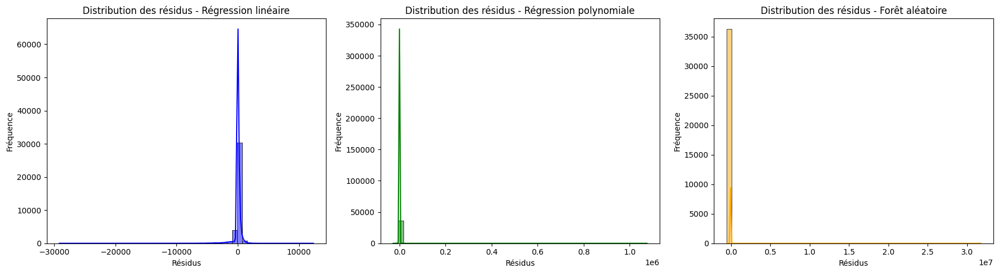

In [13]:

# Calcul des résidus pour chaque modèle
residuals_linear = y_test.ravel() - y_pred_linear.ravel()
residuals_poly = y_test.ravel() - y_pred_poly.ravel()
residuals_rf = y_test.ravel() - y_pred_rf.ravel()

# Distribution des résidus (Histogramme)
plt.figure(figsize=(18, 5))

# Résidus - Régression linéaire
plt.subplot(1, 3, 1)
sns.histplot(residuals_linear, kde=True, bins=50, color="blue")
plt.title("Distribution des résidus - Régression linéaire")
plt.xlabel("Résidus")
plt.ylabel("Fréquence")

# Résidus - Régression polynomiale
plt.subplot(1, 3, 2)
sns.histplot(residuals_poly, kde=True, bins=50, color="green")
plt.title("Distribution des résidus - Régression polynomiale")
plt.xlabel("Résidus")
plt.ylabel("Fréquence")

# Résidus - Forêt aléatoire
plt.subplot(1, 3, 3)
sns.histplot(residuals_rf, kde=True, bins=50, color="orange")
plt.title("Distribution des résidus - Forêt aléatoire")
plt.xlabel("Résidus")
plt.ylabel("Fréquence")

plt.tight_layout()
plt.show()


In [16]:

# Créer un DataFrame pour comparer les vraies valeurs et les prédictions
results_df = pd.DataFrame({
    'Vraie valeur': y_test.ravel(),
    'Régression linéaire': y_pred_linear.ravel(),
    'Régression polynomiale': y_pred_poly.ravel(),
    'Forêt aléatoire': y_pred_rf.ravel()
})

# Tracer les distributions des prédictions et des vraies valeurs
for col in results_df.columns[1:]:
    fig = px.scatter(results_df, x='Vraie valeur', y=col,
                     title=f'{col} vs Vraie valeur',
                     opacity=0.5)
    fig.add_shape(type="line",
                  x0=y_test.min(), y0=y_test.min(),
                  x1=y_test.max(), y1=y_test.max(),
                  line=dict(color="red", dash="dash"))
    fig.show()

In [15]:
import pickle

# Enregistrer le modèle de régression linéaire
with open('linear_model.pkl', 'wb') as file:
    pickle.dump(linear_model, file)

# Enregistrer le modèle de régression polynomiale
with open('poly_model.pkl', 'wb') as file:
    pickle.dump(poly_model, file)

# Enregistrer le modèle de forêt aléatoire
with open('rf_model.pkl', 'wb') as file:
    pickle.dump(rf_model, file)